In [1]:
#%load_ext nb_black
import itertools
import cv2
from matplotlib import pyplot as plt
import numpy as np
import math
import pandas as pd
from numpy import linalg as LA
from skimage.morphology import skeletonize
from skimage import data
from skimage.util import invert
import math
from scipy.signal import find_peaks
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from skimage.color import label2rgb

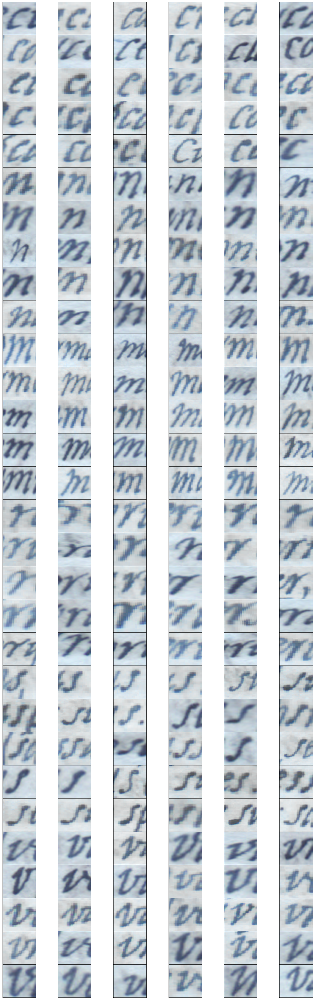

In [2]:
def originales(letra):
    originales = []
    for i in range(1, 31):
        img = cv2.imread("Letras/" + letra + str(i) + ".png")
        filas, columnas = img.shape[:2]
        y = float(210 / filas)
        x = float(210 / columnas)
        img = cv2.resize(img, None, fx=x, fy=y, interpolation=cv2.INTER_CUBIC)
        originales.append(img)
    return originales


c_original = originales("c")
n_original = originales("n")
m_original = originales("m")
r_original = originales("r")
s_original = originales("s")
v_original = originales("v")
# otras = originales("otras/")

imagenes = [
    c_original,
    n_original,
    m_original,
    r_original,
    s_original,
    v_original,
#     otras,
]
imagenes = list(itertools.chain.from_iterable(imagenes))
plt.figure(figsize=(20, 20))
for i in range(180):
    plt.subplot(30, 6, i + 1), plt.imshow(imagenes[i], cmap=plt.cm.gray)
    plt.xticks([]), plt.yticks([])
plt.subplots_adjust(top=3, bottom=0.01, left=0.01, right=1, hspace=0.001, wspace=0.05)
plt.show()

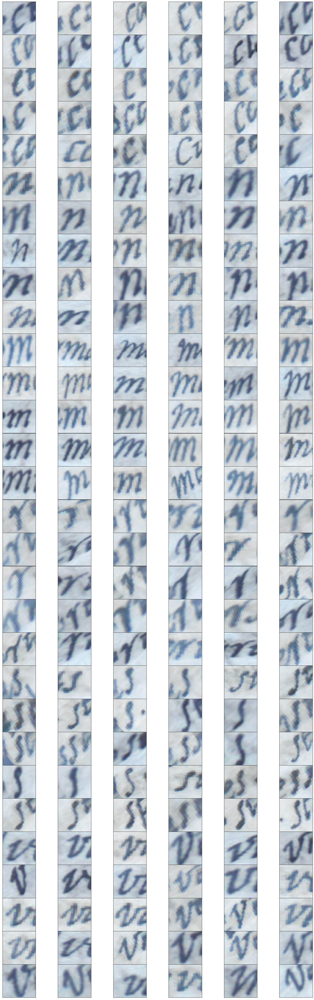

In [3]:
def slant(letras):
    slant = []
    for i in range(30):
        filas, columnas = letras[i].shape[:2]
        y = float(100 / filas)
        x = float(100 / columnas)
        img = cv2.resize(letras[i], None, fx=x, fy=y, interpolation=cv2.INTER_LINEAR)

        # Filtro de ruido y binarizacion
        # img = cv2.medianBlur(img,3)
        filas, columnas = img.shape[:2]
        gris = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        ret, thresh = cv2.threshold(
            gris, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
        )
        kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
        closing = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)
        bordes = cv2.Canny(closing, 100, 200)
        (contornos, _) = cv2.findContours(
            bordes, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE
        )
        area = []
        for j in range(0, len(contornos)):
            cnt = contornos[j]
            area.append(cv2.contourArea(cnt))
        cotorno_letra = area.index(np.max(area))
        cnt1 = contornos[cotorno_letra]
        rect = cv2.minAreaRect(cnt1)
        box = cv2.boxPoints(rect)
        box = np.int0(box)
        angle = rect[-1]
        if angle < -45:
            angle = 90 + angle
        else:
            angle = -angle
        filas, columnas = thresh.shape
        M = cv2.getRotationMatrix2D((columnas / 2, filas / 2), angle, 1)
        rotadas = cv2.warpAffine(
            img, M, (columnas, filas), borderMode=cv2.BORDER_REPLICATE
        )
        slant.append(rotadas)
    return slant


cslant = slant(c_original)
nslant = slant(n_original)
mslant = slant(m_original)
rslant = slant(r_original)
sslant = slant(s_original)
vslant = slant(v_original)
# oslant = slant(otras)

imagenes = [cslant, nslant, mslant, rslant, sslant, vslant]
imagenes = list(itertools.chain.from_iterable(imagenes))
plt.figure(figsize=(20, 20))
for i in range(180):
    plt.subplot(30, 6, i + 1), plt.imshow(imagenes[i], cmap=plt.cm.gray)
    plt.xticks([]), plt.yticks([])
plt.subplots_adjust(top=3, bottom=0.01, left=0.01, right=1, hspace=0.001, wspace=0.05)
plt.show()

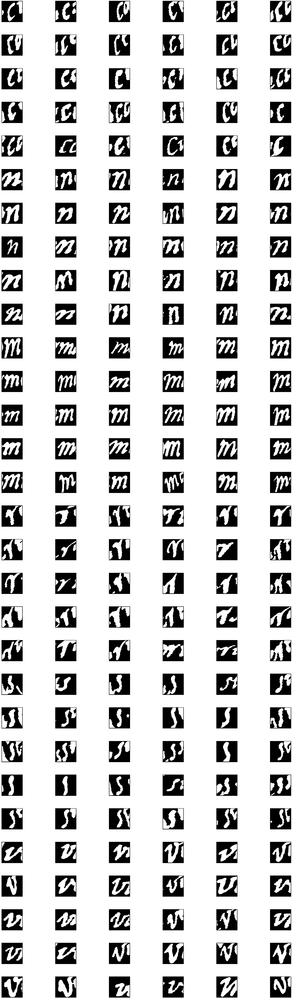

In [4]:
def kmean_bin(letra, valor_umbral):
    binarizadas = []
    for i in range(30):
        img = letra[i]
        vectorized = img.reshape((-1, 3))
        vectorized = np.float32(vectorized)
        criteria = (cv2.TERM_CRITERIA_EPS, 20, 0.5)
        K = 6
        attempts = 20
        ret, label, center = cv2.kmeans(
            vectorized, K, None, criteria, attempts, cv2.KMEANS_PP_CENTERS
        )
        center = np.uint8(center)
        res = center[label.flatten()]
        result_image = res.reshape((img.shape))

        # Convert to HSV space
        HSV_img = cv2.cvtColor(result_image, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(HSV_img)
        # hue = HSV_img[:, :, 0]

        # select maximum value of H component from histogram
        hist = cv2.calcHist([s], [0], None, [256], [0, 256])
        hist = hist[1:, :]  # suppress black value

        indices = find_peaks(hist[:, 0])[0]
        th, threshed2 = cv2.threshold(
            cv2.medianBlur(s, 3), np.mean(indices) - 7, 255, cv2.THRESH_BINARY
        )
        img = threshed2.copy()
        for i in range(img.shape[0]):
            img[i, 0] = 0
            img[i, 1] = 0
            img[i, img.shape[1] - 1] = 0
            img[i, img.shape[1] - 2] = 0
        for i in range(img.shape[1]):
            img[0, i] = 0
            img[1, i] = 0
            img[img.shape[1] - 1, i] = 0
            img[img.shape[1] - 2, i] = 0
        binarizadas.append(img)
    return binarizadas


umbral = 175
c_kbin = kmean_bin(cslant, umbral)
n_kbin = kmean_bin(nslant, umbral)
m_kbin = kmean_bin(mslant, umbral)
r_kbin = kmean_bin(rslant, umbral)
s_kbin = kmean_bin(sslant, umbral)
v_kbin = kmean_bin(vslant, umbral)
# o_kbin = kmean_bin(oslant, umbral)

imagenes = [c_kbin, n_kbin, m_kbin, r_kbin, s_kbin, v_kbin]
imagenes = list(itertools.chain.from_iterable(imagenes))

# titulos = ["c1"]
# letras_map = "cnmrsv"
# for i in range(0, 180):
#     titulos.append(letras_map[math.floor(i / 30)] + str((i % 30) + 1))
# titulos.append("v30")

plt.figure(figsize=(100, 100))
for i in range(180):
    #     plt.title(titulos[i])
    plt.subplot(30, 6, i + 1), plt.imshow(imagenes[i], cmap=plt.cm.gray)
    plt.xticks([]), plt.yticks([])
plt.subplots_adjust(
    top=1, bottom=0.01, left=0.01, right=0.33, hspace=0.6, wspace=0.00001
)
plt.savefig("kmean_bin2.png")
plt.show()

In [5]:
#%load_ext nb_black
import itertools
import cv2
from matplotlib import pyplot as plt
import numpy as np
import math
import pandas as pd
from numpy import linalg as LA
from skimage.morphology import skeletonize
from skimage import data
from skimage.util import invert
import math
from scipy.signal import find_peaks
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from skimage.color import label2rgb

from skimage.feature import hog

In [6]:
import ast
import numpy as np


def from_np_array(array_string):
    array_string = ",".join(array_string.replace("[ ", "[").split())
    return np.array(ast.literal_eval(array_string))


fd, hog_image = hog(
    imagenes[0],
    orientations=8,
    pixels_per_cell=(16, 16),
    cells_per_block=(1, 1),
    visualize=True,
)

name_columns = [
    "Letra",
    #     "Area",
    #     "Perimetro",
    #     "m00",
    #     "m10",
    #     "m01",
    #     "m20",
    #     "m11",
    #     "m02",
    #     "m30",
    #     "m21",
    #     "m12",
    #     "m03",
    #     "mu20",
    #     "mu11",
    #     "mu02",
    #     "mu30",
    #     "mu21",
    #     "mu12",
    #     "mu03",
    #     "nu20",
    #     "nu11",
    #     "nu02",
    #     "nu30",
    #     "nu21",
    #     "nu12",
    #     "nu30",
    "Hu_M 1",
    "Hu_M 2",
    "Hu_M 3",
    "Hu_M 4",
    "Hu_M 5",
    "Hu_M 6",
    "Hu_M 7",
]
name_columns.extend(
    np.core.defchararray.add(
        "hog", [str(i).zfill(3) for i in range(0, np.shape(fd)[0])],
    )
)
df = pd.DataFrame(columns=name_columns)
for i in range(len(imagenes)):
    # Operaciones Morfologicas
    # kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    # closing = cv2.morphologyEx(imagenes[i], cv2.MORPH_OPEN, kernel)
    # Detector de bordes Canny
    #     bordes = cv2.Canny(np.uint8(imagenes[i]), 100, 200)
    #     # Encontrar contornos de la letra
    #     (contornos, _) = cv2.findContours(
    #         bordes, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE
    #     )
    #     area = []
    #     for j in range(0, len(contornos)):
    #         cnt = contornos[j]
    #         area.append(cv2.contourArea(cnt))
    #     contorno_letra = area.index(np.max(area))
    #     cnt = contornos[contorno_letra]
    #     perimetro = cv2.arcLength(cnt, True)
    #     area = cv2.contourArea(cnt)
    M = cv2.moments(imagenes[i])
    #     centroide_x = int(M["m10"] / M["m00"])
    #     centroide_y = int(M["m01"] / M["m00"])
    #     suma = np.sum(cnt)
    huMoments = np.multiply(
        np.sign(cv2.HuMoments(M)), np.log10(np.abs(cv2.HuMoments(M)))
    )
    #     (cx, cy), radio = cv2.minEnclosingCircle(cnt)
    fd, hog_image = hog(
        imagenes[i],
        orientations=8,
        pixels_per_cell=(16, 16),
        cells_per_block=(1, 1),
        visualize=True,
    )
    if i < 30:
        letra = "c"
        num = 0
    elif i >= 30 and i < 60:
        letra = "n"
        num = -29
    elif i >= 60 and i < 90:
        letra = "m"
        num = -59
    elif i >= 90 and i < 120:
        letra = "r"
        num = -89
    elif i >= 120 and i < 150:
        letra = "s"
        num = -119
    elif i >= 150 and i < 180:
        letra = "v"
        num = -149
    elif i >= 180 and i < 210:
        letra = "o"
        num = -179
    row_data = [
        letra,
        #         area,
        #         perimetro,
        #         M["m00"],
        #         M["m10"],
        #         M["m01"],
        #         M["m20"],
        #         M["m11"],
        #         M["m02"],
        #         M["m30"],
        #         M["m21"],
        #         M["m12"],
        #         M["m03"],
        #         M["mu20"],
        #         M["mu11"],
        #         M["mu02"],
        #         M["mu30"],
        #         M["mu21"],
        #         M["mu12"],
        #         M["mu03"],
        #         M["nu20"],
        #         M["nu11"],
        #         M["nu02"],
        #         M["nu30"],
        #         M["nu21"],
        #         M["nu12"],
        #         M["nu30"],
        float(huMoments[0]),
        float(huMoments[1]),
        float(huMoments[2]),
        float(huMoments[3]),
        float(huMoments[4]),
        float(huMoments[5]),
        float(huMoments[6]),
    ]
    row_data.extend(fd)
    df.loc[i] = row_data
print(df)
df.to_csv("datos.csv")

df2 = pd.read_csv("datos.csv", index_col=0)
# print(df2)

    Letra    Hu_M 1    Hu_M 2     Hu_M 3     Hu_M 4     Hu_M 5     Hu_M 6  \
0       c -2.634108 -5.821545 -10.235068  -9.675653  20.056783 -12.599127   
1       c -2.739537 -6.102006  -9.594460 -10.655600 -20.782067 -14.008177   
2       c -2.838408 -6.286986  -9.466753  -9.858646 -19.613891 -13.003673   
3       c -2.744221 -6.349166  -8.947370 -10.173606  19.863436  13.472097   
4       c -2.762041 -5.968820  -9.757733  -9.964122 -19.973503 -13.239769   
..    ...       ...       ...        ...        ...        ...        ...   
175     v -2.983759 -7.620142  -9.668974 -10.771526 -21.027290 -14.583668   
176     v -3.033454 -7.908884 -10.202168 -11.973592  23.063198  16.444492   
177     v -2.781081 -6.589761  -9.299499 -10.373591 -20.248817 -13.688514   
178     v -2.990358 -7.962102  -9.996187 -12.390404 -23.751646 -16.943846   
179     v -2.923815 -7.117464  -9.623828 -10.949410 -21.312479 -14.742101   

        Hu_M 7  hog000  hog001  ...  hog278  hog279    hog280  hog281  \
0 

In [7]:
features = [
    #     "Area",
    #     "Perimetro",
    #     "m00",
    #     "m10",
    #     "m01",
    #     "m20",
    #     "m11",
    #     "m02",
    #     "m30",
    #     "m21",
    #     "m12",
    #     "m03",
    #     "mu20",
    #     "mu11",
    #     "mu02",
    #     "mu30",
    #     "mu21",
    #     "mu12",
    #     "mu03",
    #     "nu20",
    #     "nu11",
    #     "nu02",
    #     "nu30",
    #     "nu21",
    #     "nu12",
    #     "nu30",
    "Hu_M 1",
    "Hu_M 2",
    "Hu_M 3",
    "Hu_M 4",
    "Hu_M 5",
    "Hu_M 6",
    "Hu_M 7",
]
features.extend(
    np.core.defchararray.add(
        "hog", [str(i).zfill(3) for i in range(0, np.shape(fd)[0])],
    )
)
print(len(features))
from sklearn.preprocessing import StandardScaler
from scipy.stats.mstats import zscore
from sklearn.decomposition import PCA

x = df.loc[:, features].values
x = StandardScaler().fit_transform(x)
# x.to_csv("x.csv")

y = df.loc[:, ["Letra"]].values

mean = np.empty((0))
mean, eigenvectors, eigenvalues = cv2.PCACompute2(x, mean)
pca = PCA(n_components=70)
principalComponents = pca.fit_transform(x)
print("variabilidad total = " + str(sum(pca.explained_variance_ratio_) * 100) + "%")
principalDf = pd.DataFrame(
    data=principalComponents,
    columns=[
        "principal component 1",
        "principal component 2",
        "principal component 3",
        "principal component 4",
        "principal component 5",
        "principal component 6",
        "principal component 7",
        "principal component 8",
        "principal component 9",
        "principal component 10",
        "principal component 11",
        "principal component 12",
        "principal component 13",
        "principal component 14",
        "principal component 15",
        "principal component 16",
        "principal component 17",
        "principal component 18",
        "principal component 19",
        "principal component 20",
        "principal component 21",
        "principal component 22",
        "principal component 23",
        "principal component 24",
        "principal component 25",
        "principal component 26",
        "principal component 27",
        "principal component 28",
        "principal component 29",
        "principal component 30",
        "principal component 31",
        "principal component 32",
        "principal component 33",
        "principal component 34",
        "principal component 35",
        "principal component 36",
        "principal component 37",
        "principal component 38",
        "principal component 39",
        "principal component 40",
        "principal component 41",
        "principal component 42",
        "principal component 43",
        "principal component 44",
        "principal component 45",
        "principal component 46",
        "principal component 47",
        "principal component 48",
        "principal component 49",
        "principal component 50",
        "principal component 51",
        "principal component 52",
        "principal component 53",
        "principal component 54",
        "principal component 55",
        "principal component 56",
        "principal component 57",
        "principal component 58",
        "principal component 59",
        "principal component 60",
        "principal component 61",
        "principal component 62",
        "principal component 63",
        "principal component 64",
        "principal component 65",
        "principal component 66",
        "principal component 67",
        "principal component 68",
        "principal component 69",
        "principal component 70",
    ],
)

finalDf = pd.concat([principalDf, df[["Letra"]]], axis=1)
finalDf.head(180)
# principalDf

295
variabilidad total = 91.90837781217554%


,principal component 1,principal component 2,principal component 3,principal component 4,principal component 5,principal component 6,principal component 7,principal component 8,principal component 9,principal component 10,...,principal component 62,principal component 63,principal component 64,principal component 65,principal component 66,principal component 67,principal component 68,principal component 69,principal component 70,Letra
0,-4.500214,-0.632645,-1.926114,-4.921982,-1.520792,-1.715919,-0.520942,1.771823,1.418477,-1.199067,...,-0.367554,0.005107,-0.392355,-0.862320,-0.356869,-0.630294,0.554409,1.135596,-0.776285,c
1,-2.683627,0.297623,-1.812611,-1.649583,-2.995688,-2.569140,1.722812,-0.590503,3.643337,1.491443,...,-0.385550,0.607237,0.082407,0.248612,-0.536942,0.052181,-1.198401,-0.070598,0.749715,c
2,-4.610218,0.585682,3.891706,-0.607635,-0.278818,0.899628,2.953418,-2.450801,1.919004,0.371729,...,-0.328775,0.425363,0.481017,-0.373784,-0.320993,1.282147,-1.578691,0.164955,0.845521,c
3,-5.525248,2.830649,2.973509,-0.270960,2.785039,-0.651275,0.538551,2.611120,0.000070,-1.367482,...,-0.765703,1.069620,-0.838040,-0.300234,0.416739,0.645727,-0.392237,-1.109351,1.112506,c
4,-2.929836,0.680324,-2.507426,-4.453134,-2.444037,-0.839559,-0.026484,-0.824756,0.682226,-0.877137,...,0.507991,-0.456064,-0.569354,0.060981,0.479276,-0.230018,0.395251,1.100917,-0.100764,c
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175,-2.382865,5.317619,1.152086,2.952953,1.581027,0.457956,5.525774,4.201757,-1.551993,3.914758,...,-0.422671,-0.549904,0.765373,0.067256,0.477538,-0.213526,0.267585,-1.391441,-0.672541,v
176,3.774014,-4.026683,4.872245,4.432371,0.324474,-2.835830,0.379169,2.846160,6.230706,1.196414,...,1.498693,1.202804,-0.344563,-1.114256,0.055341,-1.392039,-0.375679,-0.537460,-0.484422,v
177,4.739827,-4.767663,1.744850,-2.937698,0.459664,0.854583,-0.852752,1.159610,-3.065273,0.654833,...,1.431864,1.070057,-0.614318,1.482356,-0.234327,0.295147,0.480114,-0.128850,0.010462,v
178,2.270489,1.359001,6.110410,0.265086,-1.816560,-1.129603,-4.770599,-0.148225,0.106065,3.134556,...,0.482435,-0.530065,-1.087510,-0.389330,-1.820376,-0.536801,-0.870509,0.433870,0.258361,v


70


([<matplotlib.axis.XTick at 0x1dbf0549e80>,
 <a list of 70 Text xticklabel objects>)

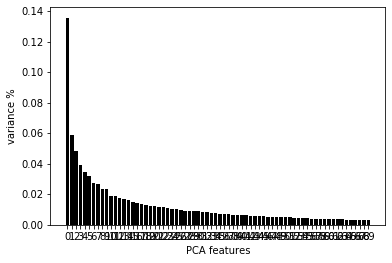

In [8]:
# Plot the explained variances
features = range(pca.n_components_)
print(pca.n_components_)
plt.bar(features, pca.explained_variance_ratio_, color="black")
plt.xlabel("PCA features")
plt.ylabel("variance %")
plt.xticks(features)

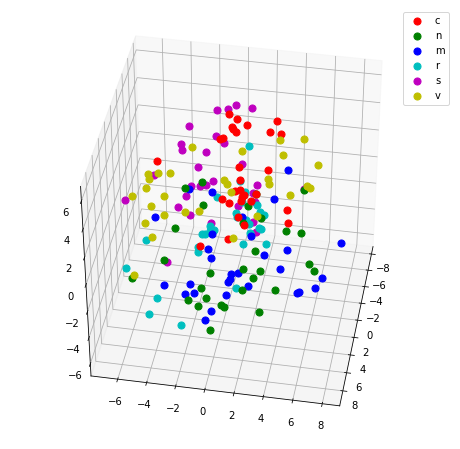

In [9]:
finalDf = pd.concat([principalDf, df[["Letra"]]], axis=1)

from mpl_toolkits.mplot3d import Axes3D  # noqa: F401 unused import

fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111, projection="3d")

targets = ["c", "n", "m", "r", "s", "v"]
colors = ["r", "g", "b", "c", "m", "y"]
for target, color in zip(targets, colors):
    indicesToKeep = finalDf["Letra"] == target
    ax.scatter(
        finalDf.loc[indicesToKeep, "principal component 1"],
        finalDf.loc[indicesToKeep, "principal component 2"],
        finalDf.loc[indicesToKeep, "principal component 3"],
        c=color,
        s=50,
        depthshade=False,
    )

ax.view_init(elev=40.0, azim=10)
ax.legend(targets)
ax.grid()

(180, 295)
[[ 1.45844253  1.09544762  1.81294199 ...  0.         -0.30515033
   0.        ]
 [-0.16172481 -0.07488607  0.43640134 ...  0.         -0.30515033
   0.        ]
 [ 2.17894713  0.31520528  1.26939318 ...  0.         -0.30515033
   0.        ]
 ...
 [ 0.79904825  1.25776693  1.31483209 ...  0.         -0.30515033
   0.        ]
 [ 1.25046163  1.22972099 -0.18540464 ...  0.         -0.30515033
   0.        ]
 [-0.34242769  0.54899386 -0.8800661  ...  0.         -0.30515033
   0.        ]]
Iteration 1, loss = 1.82246998
Iteration 2, loss = 1.76184551
Iteration 3, loss = 1.70589275
Iteration 4, loss = 1.65320219
Iteration 5, loss = 1.59539350
Iteration 6, loss = 1.52716980
Iteration 7, loss = 1.44916027
Iteration 8, loss = 1.36517062
Iteration 9, loss = 1.27874390
Iteration 10, loss = 1.19184538
Iteration 11, loss = 1.10535015
Iteration 12, loss = 1.01996136
Iteration 13, loss = 0.93664839
Iteration 14, loss = 0.85651003
Iteration 15, loss = 0.78044729
Iteration 16, loss = 0.708

c:\users\luis\appdata\local\programs\python\python37\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:921: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\users\luis\appdata\local\programs\python\python37\lib\site-packages\sklearn\neural_network\multilayer_perceptron.py:566: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (20) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


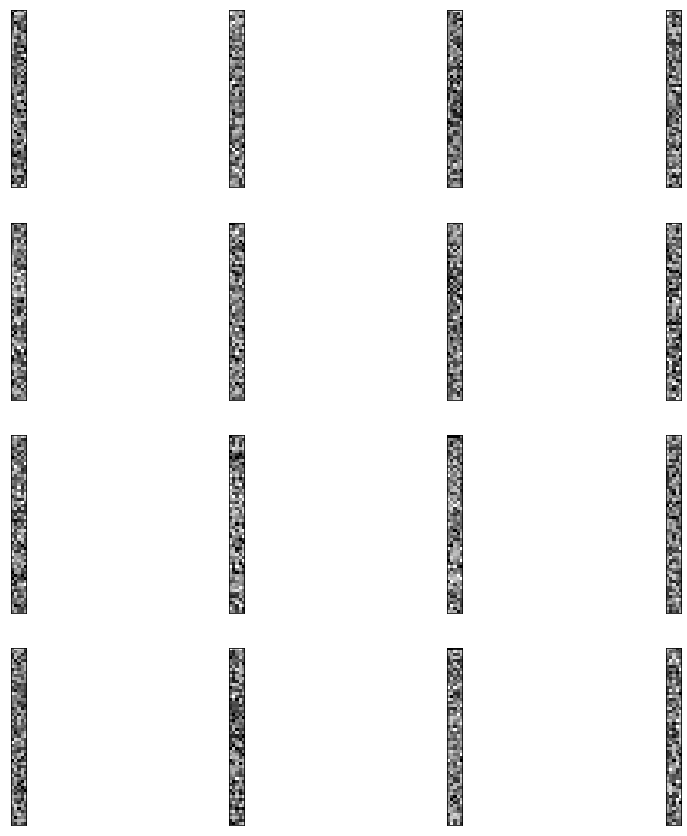

In [10]:
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import confusion_matrix

mlp = MLPClassifier(
    hidden_layer_sizes=(50,),
    max_iter=20,
    alpha=1e-4,
    activation="logistic",
    solver="sgd",
    verbose=10,
    random_state=1,
    learning_rate_init=0.1,
)

x = StandardScaler().fit_transform(x)
print(x.shape)
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2)
print(X_train)
mlp.fit(X_train, y_train)
res = mlp.predict(X_train)
cm = confusion_matrix(y_train, res)
print(cm)
print("Training set score: %f" % mlp.score(X_train, y_train))
print("Test set score: %f" % mlp.score(X_test, y_test))

fig, axes = plt.subplots(4, 4, figsize=(15, 15))
# use global min / max to ensure all weights are shown on the same scale
vmin, vmax = mlp.coefs_[0].min(), mlp.coefs_[0].max()
for coef, ax in zip(mlp.coefs_[0].T, axes.ravel()):
    ax.matshow(coef.reshape(59, 5), cmap=plt.cm.gray, vmin=0.5 * vmin, vmax=0.5 * vmax)
    ax.set_xticks(())
    ax.set_yticks(())

plt.show()

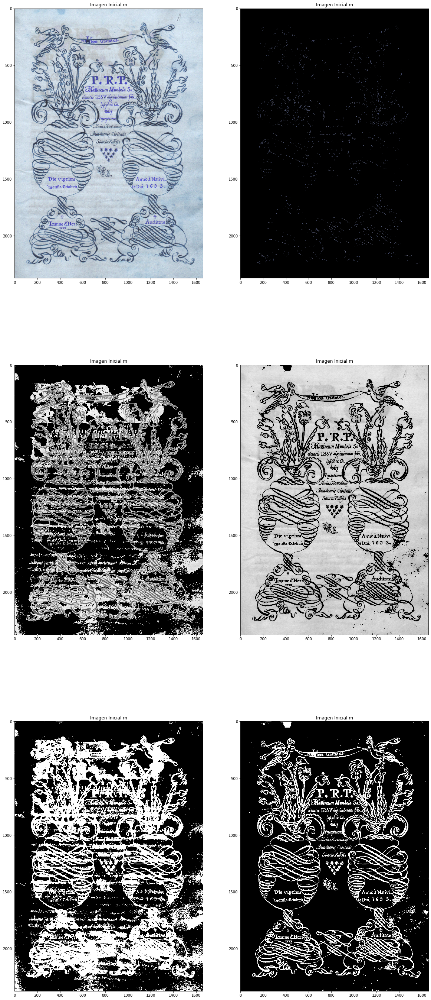

In [11]:
#%load_ext nb_black
import numpy as np
import cv2
from matplotlib import pyplot as plt
from skimage.morphology import skeletonize
import random as rng

img = cv2.imread("Hojas/rm_149_002.tif")
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
h, s, v = cv2.split(hsv)

light_orange = (
    round(14 / 2),
    round(255 * 0.3923),
    round(255 * 0.5098),
)  # 14°, 14.62%, 67.06%

mask = cv2.inRange(hsv, (0, 0, 0), light_orange)
dst1 = cv2.bitwise_and(img, img, mask=mask)

th, threshed = cv2.threshold(v, 210, 255, cv2.THRESH_BINARY_INV)
dst2 = cv2.bitwise_and(img, img, mask=threshed)

th, threshed2 = cv2.threshold(s, 55, 255, cv2.THRESH_BINARY_INV)
dst3 = cv2.bitwise_and(img, img, mask=threshed2)

# cv2.imwrite("dst1.png", dst1)
# cv2.imwrite("dst2.png", dst2)
cv2.imwrite("dst3.png", dst3)


dst2 = cv2.cvtColor(dst2, cv2.COLOR_BGR2GRAY)
dst3 = cv2.cvtColor(dst3, cv2.COLOR_BGR2GRAY)

th, threshed_dst2 = cv2.threshold(dst2, 0, 100, cv2.THRESH_BINARY)
th, threshed_dst3 = cv2.threshold(dst3, 20, 255, cv2.THRESH_BINARY_INV)
dst4 = cv2.bitwise_and(threshed_dst2, threshed_dst3)
th, threshed_dst4 = cv2.threshold(dst4, 20, 255, cv2.THRESH_BINARY)

# cv2.imwrite("threshed_dst2.png", threshed_dst2)
cv2.imwrite("threshed_dst3.png", threshed_dst3)
# cv2.imwrite("threshed_dst4.png", threshed_dst4)
dst3 = cv2.cvtColor(dst3, cv2.COLOR_GRAY2RGB)

plt.figure(figsize=(20, 50))
plt.subplot(3, 2, 1), plt.imshow(img, cmap=plt.cm.gray), plt.title("Imagen Inicial m")
plt.subplot(3, 2, 2), plt.imshow(dst1, cmap=plt.cm.gray), plt.title("Imagen Inicial m")
plt.subplot(3, 2, 3), plt.imshow(dst2, cmap=plt.cm.gray), plt.title("Imagen Inicial m")
plt.subplot(3, 2, 4), plt.imshow(dst3), plt.title("Imagen Inicial m")
plt.subplot(3, 2, 5), plt.imshow(threshed_dst2, cmap=plt.cm.gray), plt.title(
    "Imagen Inicial m"
)
plt.subplot(3, 2, 6), plt.imshow(threshed_dst3, cmap=plt.cm.gray), plt.title(
    "Imagen Inicial m"
)

plt.show()

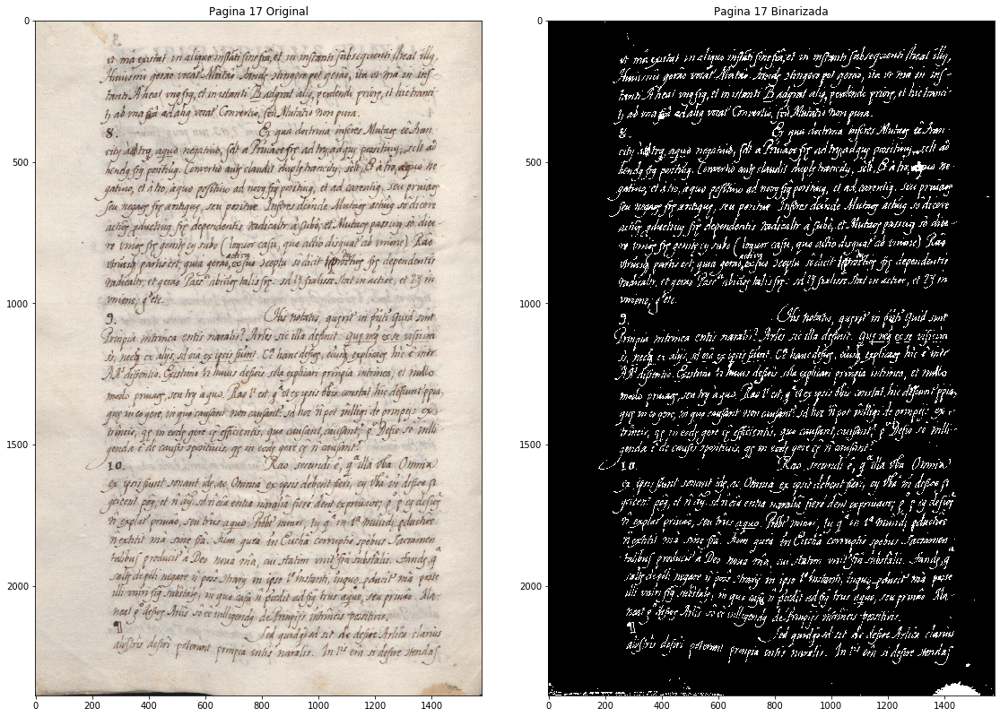

In [12]:
## (1) lectura de imagen
gray = cv2.imread("Hojas/rm_149_008.tif", 0)
img = cv2.imread("Hojas/rm_149_008.tif")
h_gray, w_gray = gray.shape[:2]
gray = gray[0 : h_gray - 50, 0:w_gray]
blur = cv2.GaussianBlur(gray, (5, 5), 0)

img = cv2.imread("Hojas/rm_149_008.tif")
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
h, s, v = cv2.split(hsv)

## (2) binarización
light_orange = (
    round(23 / 2),
    round(255 * 0.0984),
    round(255 * 0.7176),
)  # 23°, 9.84%, 71.76%
dark_orange = (
    round(14 / 2),
    round(255 * 0.3923),
    round(255 * 0.5098),
)  # 14°, 14.62%, 67.06%

mask = cv2.inRange(hsv, (0, 0, 0), dark_orange)
dst1 = cv2.bitwise_and(img, img, mask=mask)

th, threshed = cv2.threshold(v, 210, 255, cv2.THRESH_BINARY_INV)
dst2 = cv2.bitwise_and(img, img, mask=threshed)

th, threshed2 = cv2.threshold(s, 50, 255, cv2.THRESH_BINARY_INV)
dst3 = cv2.bitwise_and(img, img, mask=threshed2)

cv2.imwrite("dst1.png", dst1)
cv2.imwrite("dst2.png", dst2)
cv2.imwrite("dst3.png", dst3)


dst2 = cv2.cvtColor(dst2, cv2.COLOR_BGR2GRAY)
dst3 = cv2.cvtColor(dst3, cv2.COLOR_BGR2GRAY)

th, threshed_dst2 = cv2.threshold(dst2, 0, 100, cv2.THRESH_BINARY)
th, threshed_dst3 = cv2.threshold(dst3, 20, 255, cv2.THRESH_BINARY_INV)
dst4 = cv2.bitwise_and(threshed_dst2, threshed_dst3)
th, threshed_dst4 = cv2.threshold(dst4, 0, 255, cv2.THRESH_BINARY)

cv2.imwrite("threshed_dst2.png", threshed_dst2)
cv2.imwrite("threshed_dst3.png", threshed_dst3)
cv2.imwrite("threshed_dst4.png", threshed_dst4)

img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(15, 15))
plt.subplot(121), plt.imshow(img)
plt.title("Pagina 17 Original")
plt.subplot(122), plt.imshow(threshed_dst4, cmap=plt.cm.gray)
plt.title("Pagina 17 Binarizada")
plt.subplots_adjust(top=1, bottom=0.01, left=0.01, right=1, hspace=0.1, wspace=0.15)
plt.show()

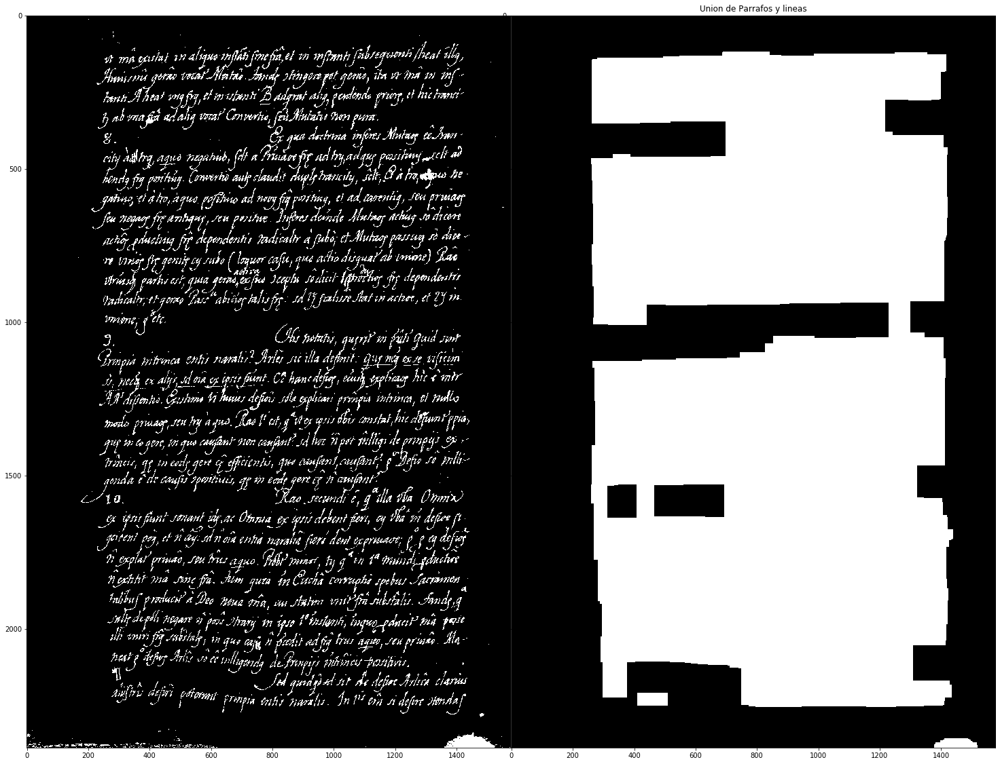

In [13]:
## (3) toma de esquinas correspondientes al area de todo el texto
kernelp11 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (4, 4))
filtroAp = cv2.morphologyEx(threshed_dst4, cv2.MORPH_OPEN, kernelp11)
filtroCier = cv2.morphologyEx(filtroAp, cv2.MORPH_CLOSE, kernelp11)
kernelp11 = cv2.getStructuringElement(cv2.MORPH_RECT, (100, 2))
cerradaP11_1 = cv2.morphologyEx(filtroCier, cv2.MORPH_CLOSE, kernelp11)
kernelp11 = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 60))
cerradaP11_2 = cv2.morphologyEx(cerradaP11_1, cv2.MORPH_CLOSE, kernelp11)
kernelp11 = cv2.getStructuringElement(cv2.MORPH_RECT, (50, 20))
abiertaP11_3 = cv2.morphologyEx(cerradaP11_2, cv2.MORPH_OPEN, kernelp11)
kernelp11 = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 100))
abiertaP11_4 = cv2.morphologyEx(abiertaP11_3, cv2.MORPH_CLOSE, kernelp11)


## (6) Show everything
plt.figure(figsize=(20, 20))
plt.subplot(121), plt.imshow(threshed_dst4, cmap=plt.cm.gray)
plt.subplot(122), plt.imshow(abiertaP11_4, cmap=plt.cm.gray)
plt.title("Union de Parrafos y lineas")
# plt.subplot(223), plt.imshow(cerradaP11_1, cmap=plt.cm.gray)
# plt.title( "cerradaP11_1")
plt.subplots_adjust(top=1, bottom=0.01, left=0.01, right=1, hspace=0.1, wspace=0.001)
plt.show()

1257
-0.05175768956542015
1257
-0.05175768956542015


<Figure size 864x864 with 0 Axes>

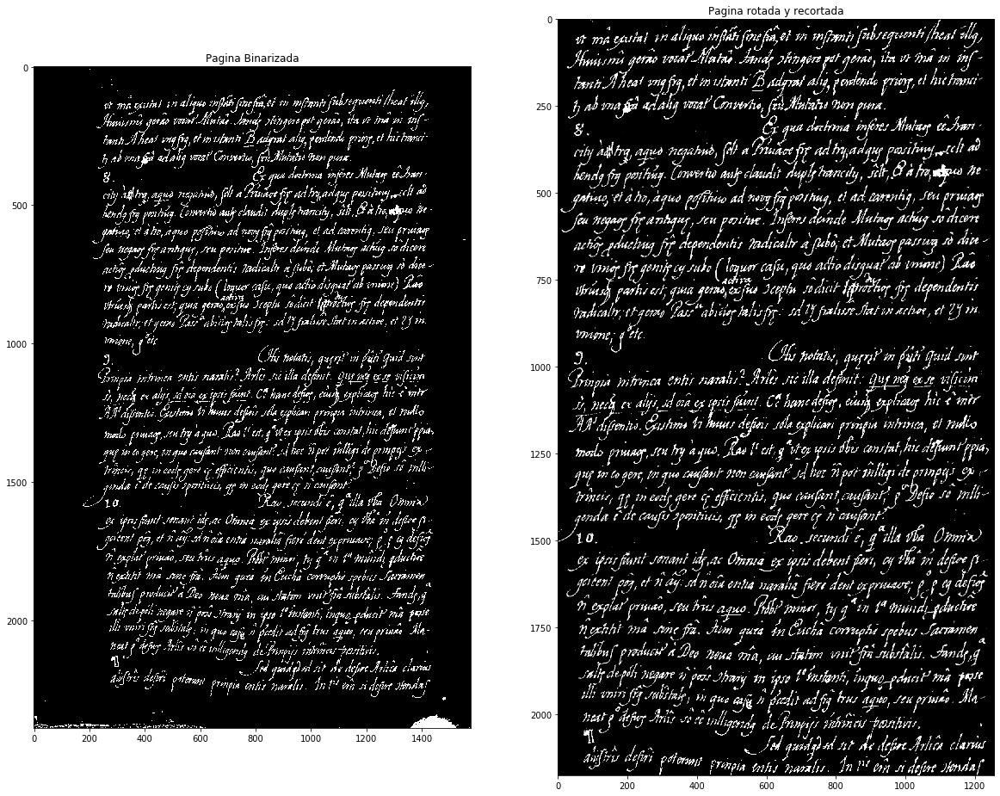

In [14]:
plt.figure(figsize=(12, 12))
centroide_x = []
centroide_y = []
Imagenes = []


def crop_rect(img, rect):
    # get the parameter of the small rectangle
    center, size, angle = rect[0], rect[1], rect[2]
    center, size = tuple(map(int, center)), tuple(map(int, size))
    # get row and col num in img
    height, width = img.shape[0], img.shape[1]
    print(size[0])
    print(angle)
    if angle < -45:
        angle = 90 + angle
        x = size[1]
        y = size[0]
    else:
        angle = angle
        x = size[0]
        y = size[1]
    # calculate the rotation matrix
    M = cv2.getRotationMatrix2D(center, angle, 1)
    # rotate the original image
    img_rot = cv2.warpAffine(img, M, (width, height))

    # now rotated rectangle becomes vertical and we crop it
    img_crop = cv2.getRectSubPix(img_rot, (x, y), center)

    return img_crop


abierta = abiertaP11_4.copy()
# find contours / rectangle
(contornos, _) = cv2.findContours(abierta, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

area = []
for j in range(0, len(contornos)):
    cnt = contornos[j]
    area.append(cv2.contourArea(cnt))
contorno_max = area.index(np.max(area))
rect = np.array(cv2.minAreaRect(contornos[contorno_max]))
offset = 20
rect[0] = tuple(map(sum, zip(rect[0], (-0.8 * offset, -0.8 * offset))))
rect[1] = tuple(map(sum, zip(rect[1], (offset * 4, offset * 2))))

# crop
img_croped = crop_rect(threshed_dst4, rect)
img0_croped = crop_rect(img, rect)

plt.figure(figsize=(20, 20))
plt.subplot(1, 2, 1)
plt.imshow(threshed_dst4, cmap=plt.cm.gray)
plt.title("Pagina Binarizada")
plt.subplot(1, 2, 2)
plt.imshow(img_croped, cmap=plt.cm.gray)
plt.title("Pagina rotada y recortada")
plt.show()

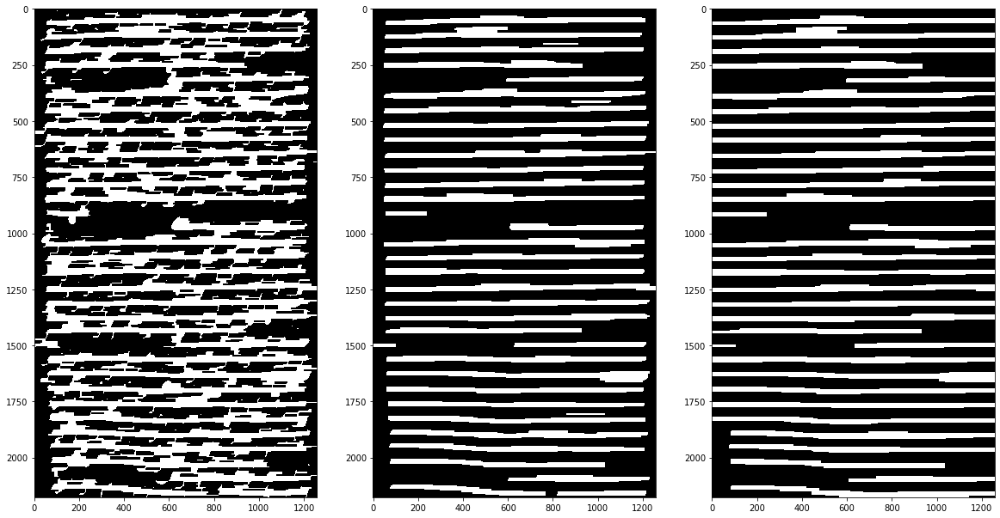

Hay 34 Renglones


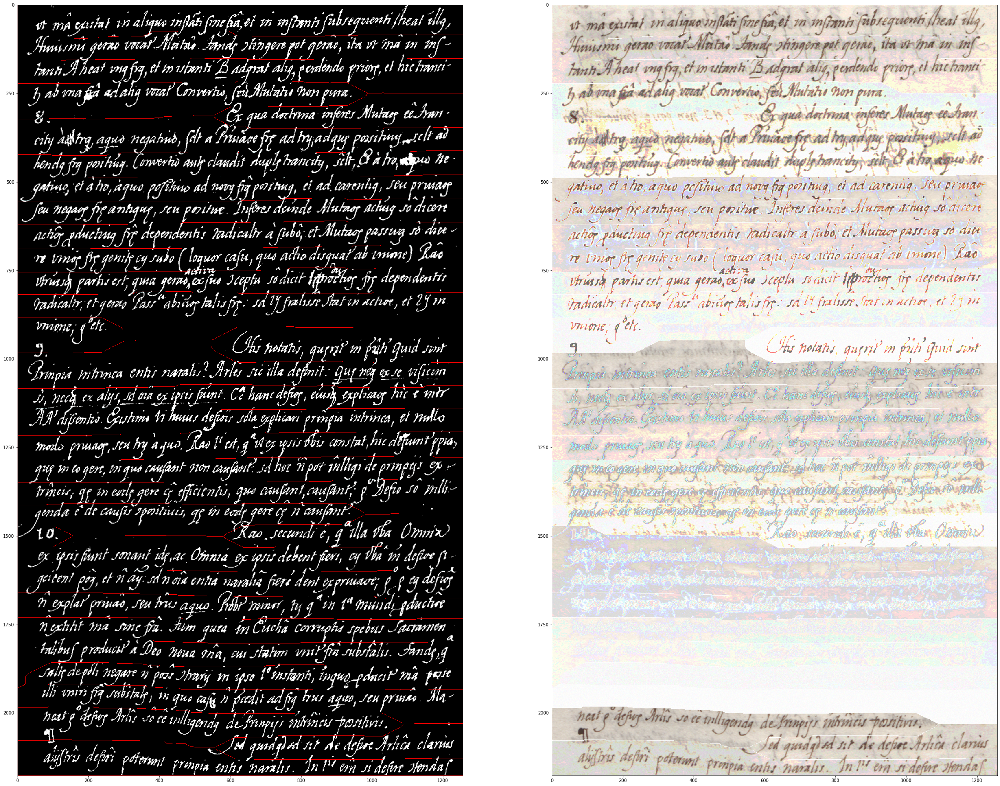

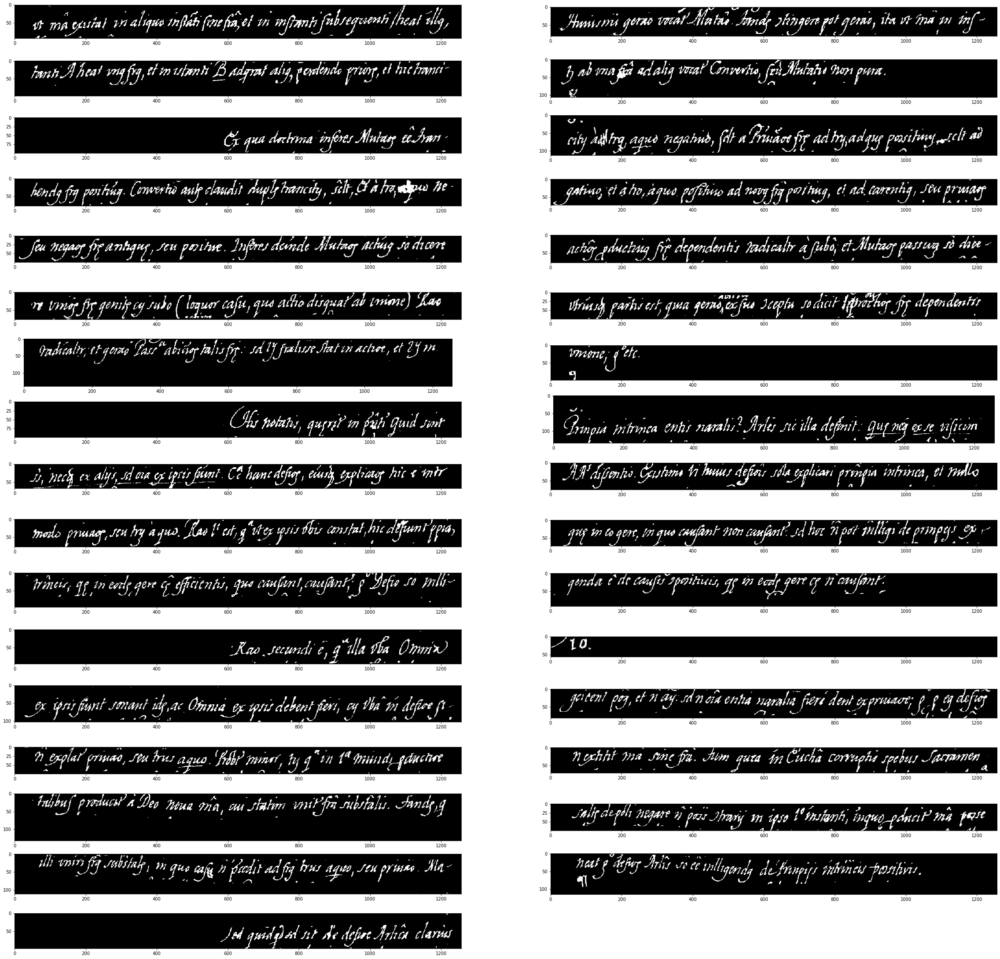

In [15]:
img_c_2 = img_croped.copy()
img_c_th_2 = cv2.threshold(img_c_2, 20, 255, cv2.THRESH_BINARY)[1]

kernel_2 = cv2.getStructuringElement(cv2.MORPH_RECT, (50, 8))
cerrada_2 = cv2.morphologyEx(img_c_th_2, cv2.MORPH_CLOSE, kernel_2)

kernel_2 = cv2.getStructuringElement(cv2.MORPH_RECT, (150, 8))
abierta_2 = cv2.morphologyEx(cerrada_2, cv2.MORPH_OPEN, kernel_2)
cerrada_3 = cv2.morphologyEx(abierta_2, cv2.MORPH_CLOSE, kernel_2)
kernel_2 = cv2.getStructuringElement(cv2.MORPH_RECT, (150, 12))
abierta_3 = cv2.morphologyEx(cerrada_3, cv2.MORPH_OPEN, kernel_2)
cerrada_4 = cv2.morphologyEx(abierta_3, cv2.MORPH_CLOSE, kernel_2)

plt.figure(figsize=(20, 20))
plt.subplot(1, 3, 1)
plt.imshow(cerrada_2, cmap=plt.cm.gray)
plt.subplot(1, 3, 2)
plt.imshow(abierta_2, cmap=plt.cm.gray)
plt.subplot(1, 3, 3)
plt.imshow(cerrada_4, cmap=plt.cm.gray)
plt.show()

cv2.imwrite("cerrada_4.png", cerrada_4)

img_c_2 = img0_croped.copy()
img_c_th_2 = cv2.threshold(img_c_2, 20, 255, cv2.THRESH_BINARY)[1]
# noise removal
opening = cerrada_4.copy()

# sure background area
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
sure_bg = cv2.dilate(opening, kernel, iterations=10)

# Finding sure foreground area
dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
ret, sure_fg = cv2.threshold(dist_transform, 0.2 * dist_transform.max(), 255, 0)

# Finding unknown region
sure_fg = np.uint8(sure_fg)
unknown = cv2.subtract(sure_bg, sure_fg)

# Marker labelling
ret, markers = cv2.connectedComponents(sure_fg)

# Add one to all labels so that sure background is not 0, but 1
# markers = markers + 1


# Now, mark the region of unknown with zero
# markers[unknown == 255] = 0

blank_image2 = 255 * np.ones(
    shape=[img_c_2.shape[0], img_c_2.shape[1], 3], dtype=np.uint8
)

lineas_sep = cv2.cvtColor(img_croped.copy(), cv2.COLOR_GRAY2RGB)
markers = cv2.watershed(blank_image2, markers)
lineas_sep[markers == -1] = [255, 0, 0]
plt.figure(figsize=(40, 40))
plt.subplot(1, 2, 1), plt.imshow(lineas_sep, cmap=plt.cm.plasma)
backtorgb = cv2.cvtColor((markers * 8).astype("uint8"), cv2.COLOR_GRAY2RGB)
markers_lineas = cv2.bitwise_or(backtorgb, img_c_2)
plt.subplot(1, 2, 2), plt.imshow(markers_lineas, cmap=plt.cm.plasma)

renglones = np.max(markers)
print("Hay " + str(renglones) + " Renglones")
renglon = []
renglon_morph = []
for i in range(1, renglones):
    thresh_n = markers == i
    linea = cv2.bitwise_or(img_croped, img_croped, mask=np.uint8(thresh_n))
    # linea_sinruido = cv2.bitwise_or(linea)
    th_c = np.uint8(thresh_n.copy())

    # Find contours
    contours, _ = cv2.findContours(th_c, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    # Approximate contours to polygons + get bounding rects and circles
    contours_poly = [None] * len(contours)
    boundRect = [None] * len(contours)
    for i, c in enumerate(contours):
        contours_poly[i] = cv2.approxPolyDP(c, 3, True)
        boundRect[i] = cv2.boundingRect(contours_poly[i])
    posx = boundRect[0][0]
    posy = boundRect[0][1]
    w = boundRect[0][2]
    h = boundRect[0][3]
    cropped = linea[posy : posy + h, :]
    cropped_bin = cerrada_4[posy : posy + h, :]
    renglon.append(cropped)
    renglon_morph.append(cropped_bin)

plt.figure(figsize=(40, 40))
for j in range(len(renglon)):
    plt.subplot(int(len(renglon) / 2) + 1, 2, j + 1), plt.imshow(
        renglon[j], cmap=plt.cm.gray
    )

# VENTANA DESLIZANTE

c:\users\luis\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:111: RuntimeWarning: divide by zero encountered in log10
c:\users\luis\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:111: RuntimeWarning: invalid value encountered in multiply


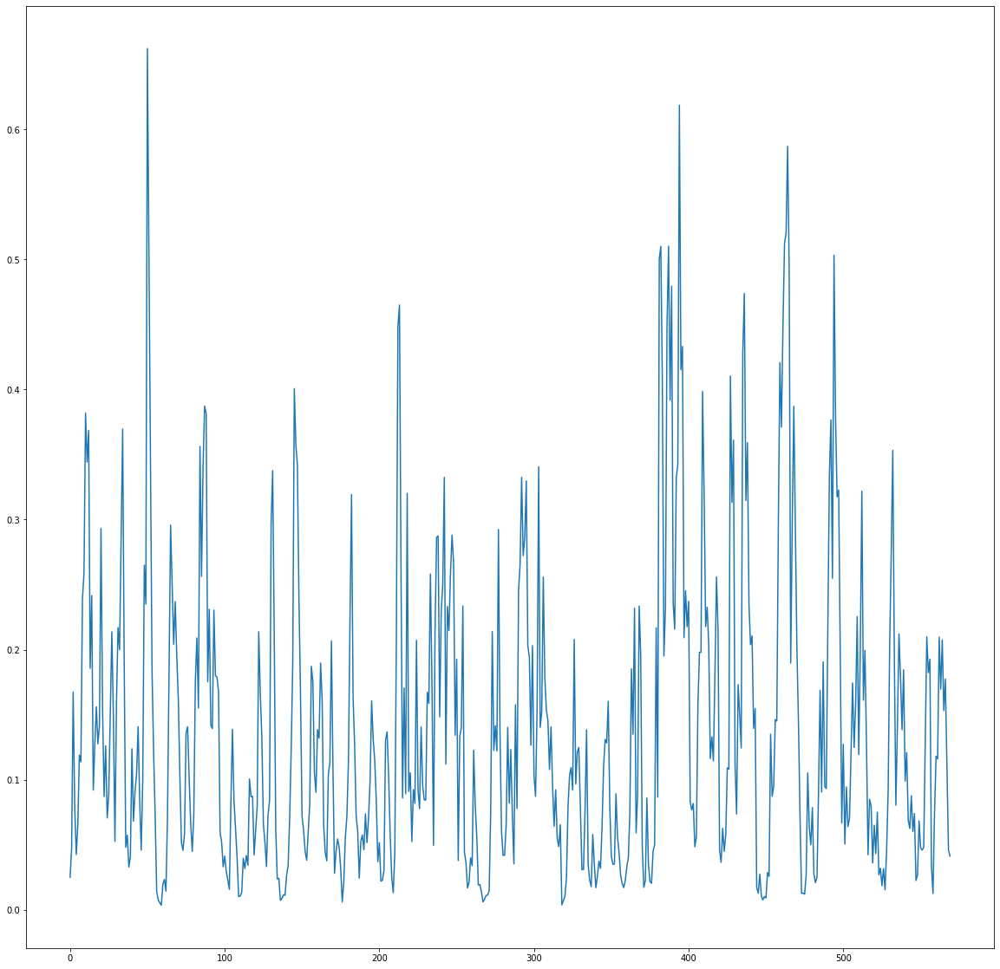

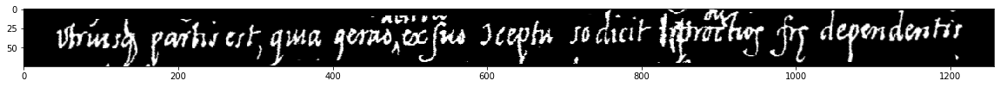

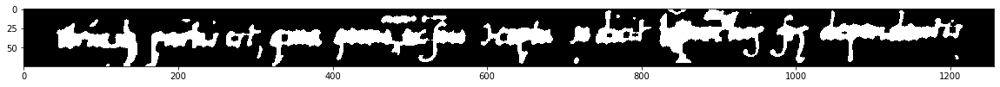

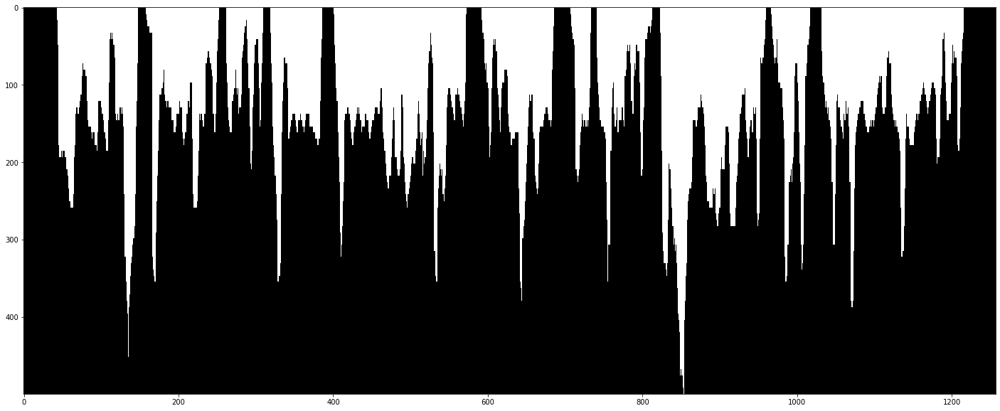

7.420155763626099


In [16]:
import time
start_time = time.time()
linea_c = renglon[11].copy()


filas, columnas = linea_c.shape[:2]


phas = 20
pts1 = np.float32([[phas, 0], [columnas, 0], [0, filas], [columnas - phas, filas]])
pts2 = np.float32([[0, 0], [columnas, 0], [0, filas], [columnas, filas]])

M = cv2.getPerspectiveTransform(pts1, pts2)

linea_c_deslant = cv2.warpPerspective(linea_c, M, (columnas, filas))

linea_c_deslant_mb = cv2.threshold(
    cv2.medianBlur(linea_c_deslant, 5), 20, 255, cv2.THRESH_BINARY
)[1]

kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 5))
cerrada = cv2.morphologyEx(linea_c_deslant_mb, cv2.MORPH_CLOSE, kernel)

name_columns = [
    "Hu_M 1",
    "Hu_M 2",
    "Hu_M 3",
    "Hu_M 4",
    "Hu_M 5",
    "Hu_M 6",
    "Hu_M 7",
]
name_columns.extend(
    np.core.defchararray.add(
        "hog", [str(i).zfill(3) for i in range(0, np.shape(fd)[0])],
    )
)
#print(np.shape(name_columns))

df = pd.DataFrame(columns=name_columns)

features = [
    #     "Area",
    #     "Perimetro",
    #     "m00",
    #     "m10",
    #     "m01",
    #     "m20",
    #     "m11",
    #     "m02",
    #     "m30",
    #     "m21",
    #     "m12",
    #     "m03",
    #     "mu20",
    #     "mu11",
    #     "mu02",
    #     "mu30",
    #     "mu21",
    #     "mu12",
    #     "mu03",
    #     "nu20",
    #     "nu11",
    #     "nu02",
    #     "nu30",
    #     "nu21",
    #     "nu12",
    #     "nu30",
    "Hu_M 1",
    "Hu_M 2",
    "Hu_M 3",
    "Hu_M 4",
    "Hu_M 5",
    "Hu_M 6",
    "Hu_M 7",
]
features.extend(
    np.core.defchararray.add(
        "hog", [str(i).zfill(3) for i in range(0, np.shape(fd)[0])],
    )
)

fil, col = linea_c_deslant.shape
i = 0
k = 0
window = []
probability = []
for i in range(col-50):
    if i % 2 == 0:
        corte_i = linea_c_deslant[0:fil, i + 20 : i + 40]
        #plt.imshow(corte_i, cmap=plt.cm.gray)
        #print(np.unique(corte_i))
        window.append(corte_i)
        filas, columnas = corte_i.shape[:2]
        y = float(100 / filas)
        x = float(100 / columnas)
        corte_i = cv2.resize(corte_i, None, fx=x, fy=y, interpolation=cv2.INTER_CUBIC)

        #print(np.shape(corte_i))
        gris = corte_i.copy()
        th, threshed2 = cv2.threshold(
            cv2.medianBlur(gris, 3), np.mean(corte_i) - 7, 255, 0
        )
        img = threshed2.copy()
        #print(np.shape(img))
        M = cv2.moments(img)
        #     centroide_x = int(M["m10"] / M["m00"])
        #     centroide_y = int(M["m01"] / M["m00"])
        #     suma = np.sum(cnt)
        huMoments = np.multiply(
            np.sign(cv2.HuMoments(M)), np.log10(np.abs(cv2.HuMoments(M)))
        )
        #     (cx, cy), radio = cv2.minEnclosingCircle(cnt)
        fd, hog_image = hog(
            img,
            orientations=8,
            pixels_per_cell=(16, 16),
            cells_per_block=(1, 1),
            visualize=True,
        )
        if huMoments[0]!=0 and huMoments[1]!=0 and huMoments[2]!=0 and huMoments[3]!=0 and huMoments[4]!=0 and huMoments[5]!=0 and huMoments[6]!=0:
            row_data = [
                float(huMoments[0]),
                float(huMoments[1]),
                float(huMoments[2]),
                float(huMoments[3]),
                float(huMoments[4]),
                float(huMoments[5]),
                float(huMoments[6]),
            ]
        if np.sum(fd) != 0:
            row_data.extend(fd)
            df.loc[k] = row_data
            k += 1

x = df.loc[:, features].values
x = StandardScaler().fit_transform(x)
probabilidad = mlp.predict_proba(x)[:,1]
#print(probabilidad)
plt.figure(figsize=(20, 20))
plt.plot(probabilidad)
plt.show()
#     clone = linea_c_deslant.copy()
#     cv2.rectangle(clone, (i, 0), (i+35,fil), (255, 255, 255), 2)
#     cv2.imshow("Window", clone)
#     cv2.waitKey(1)
#     time.sleep(0.025)
#     cv2.destroyAllWindows

proj = np.sum(cerrada, 0)
m = 500
w = np.max(proj)
result = np.zeros((500, cerrada.shape[1]))


for col in range(cerrada.shape[1]):
    cv2.line(result, (col, 0), (col, int(proj[col] * m / w)), (255, 255, 255), 1)

plt.figure(figsize=(20, 20))
plt.imshow(linea_c_deslant, cmap=plt.cm.gray)
plt.show()
plt.figure(figsize=(20, 20))
plt.imshow(cerrada, cmap=plt.cm.gray)
plt.show()
plt.figure(figsize=(160, 10))
plt.imshow(result, cmap=plt.cm.gray)
plt.show()
elapsed_time = time.time() - start_time
print(elapsed_time)

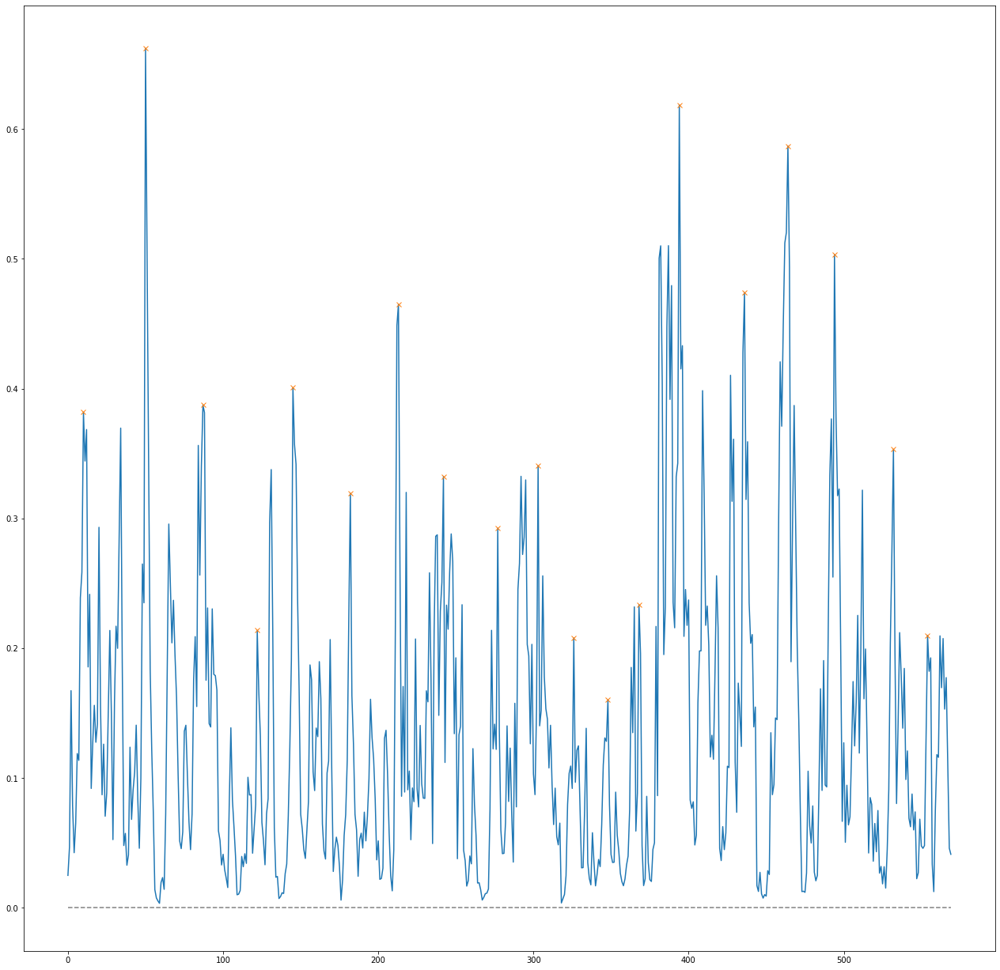

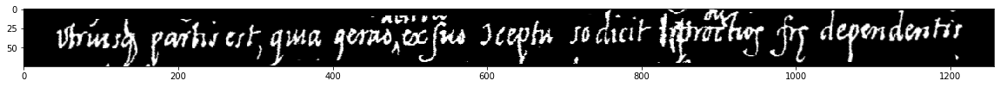

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

In [17]:
from scipy.signal import find_peaks
peaks, _ = find_peaks(probabilidad, height=0.15,distance=20)
plt.figure(figsize=(22, 22))
plt.plot(probabilidad)
plt.plot(peaks, probabilidad[peaks], "x")
plt.plot(np.zeros_like(probabilidad), "--", color="gray")
plt.show()

plt.figure(figsize=(20, 20))
plt.imshow(linea_c_deslant, cmap=plt.cm.gray)
plt.show()
plt.figure()

In [18]:
print (peaks)

[ 10  50  87 122 145 182 213 242 277 303 326 348 368 394 436 464 494 532
 554]


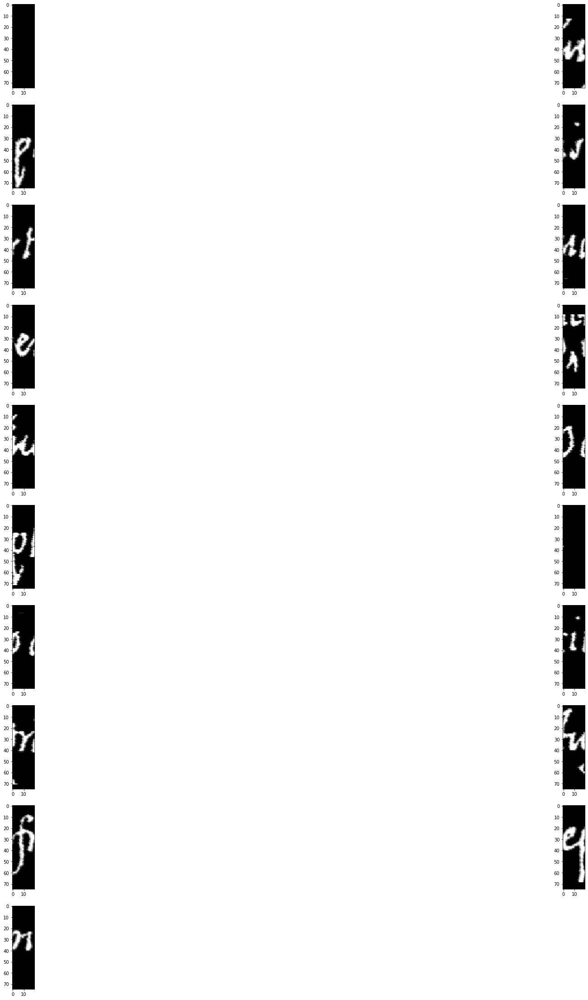

In [19]:
def imagen_a_caracteristicas (imagen):
    i = 0
    imagen_picos = []
    for i in range (len(peaks)):
        fil,col = np.shape(imagen)[:2]
        imagen_picos.append(imagen[0:filas,(peaks[i]*2)-10: (peaks[i]*2)+10])
    return imagen_picos

imagen_picos = imagen_a_caracteristicas(linea_c_deslant)

plt.figure(figsize=(40, 40))
for j in range(len(imagen_picos)):
    plt.subplot(int(len(imagen_picos) / 2) + 1, 2, j + 1), plt.imshow(
        imagen_picos[j], cmap=plt.cm.gray
    )

15810
11
[105, 95, 48, 67, 172, 94, 27, 72, 137, 51, 184]


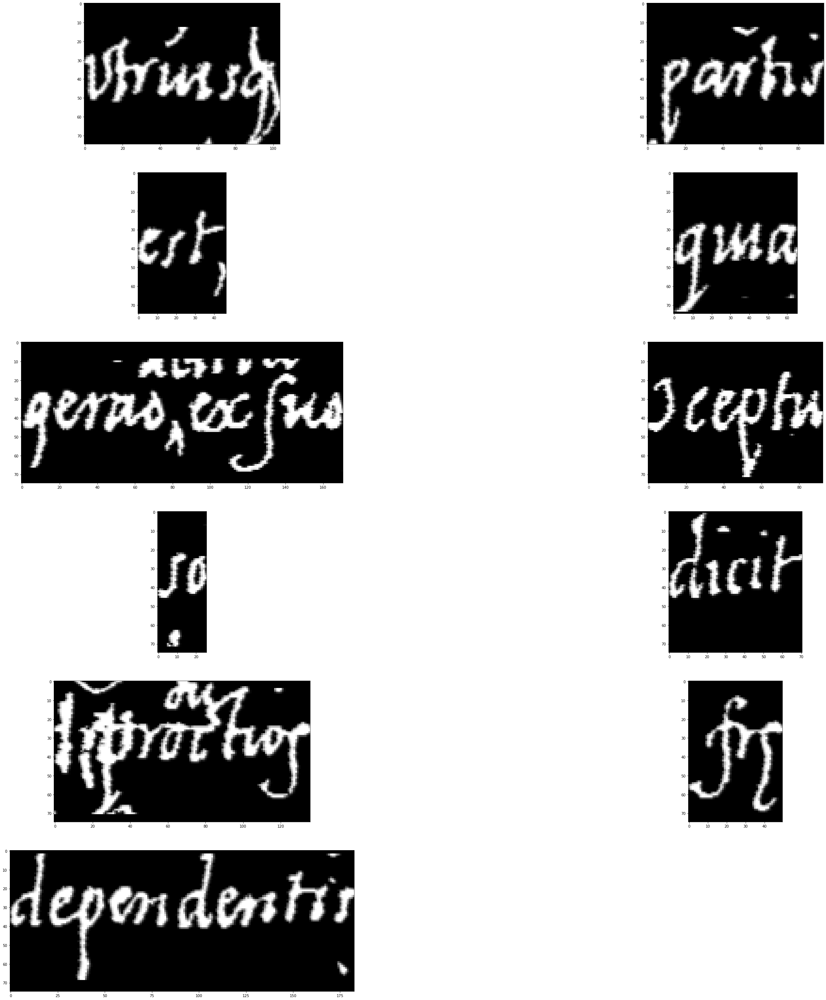

In [20]:
mayor = np.max(proj)
menor = np.min(proj)
print(mayor)

contador = []
a = 0
coords = []
palabra = []
minimo = 0
x = 0
y = 0
for i in range(len(proj)):
    if proj[i] > 1:
        a = a + 1
        if x == 0:
            x = i
        y = i
        coords.append(i)
        # print(coords)
    else:
        if a > 1:
            minimo = x
            maximo = y
            cropped = linea_c_deslant[0:filas, minimo:maximo]
            palabra.append(cropped)
            x = 0
            contador.append(a)
            # print(maximo)
        a = 0
print(len(contador))
print(contador)
# print(proj[col])

plt.figure(figsize=(50, 50))
for j in range(len(palabra)):
    plt.subplot(int(len(palabra) / 2) + 1, 2, j + 1), plt.imshow(
        palabra[j], cmap=plt.cm.gray
    )

20


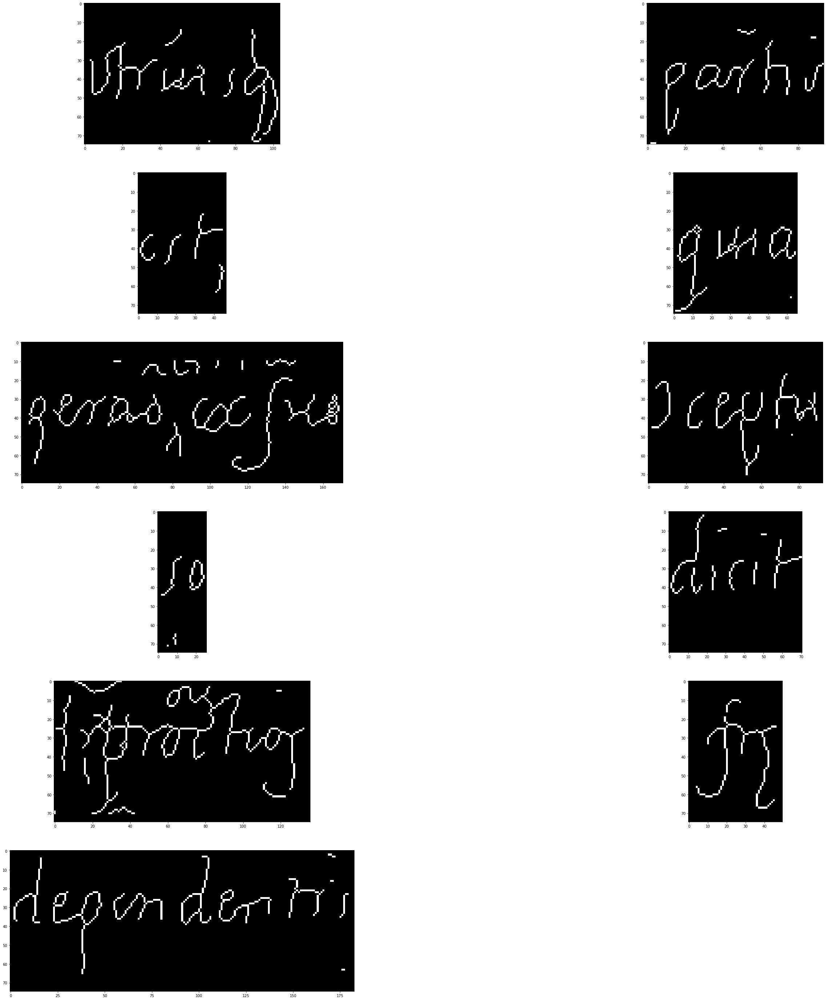

In [21]:
from skimage.morphology import skeletonize

skeletonization = []
i = 0
j = 0
for i in range(len(palabra)):
    ret, palabra_c_mb = cv2.threshold(palabra[i], 127, 255, cv2.THRESH_BINARY)
    skeletonization.append(skeletonize(palabra_c_mb, method="lee"))

print(columnas)
plt.figure(figsize=(50, 50))
for j in range(len(skeletonization)):
    plt.subplot(int(len(skeletonization) / 2) + 1, 2, j + 1), plt.imshow(
        skeletonization[j], cmap=plt.cm.gray
    )

0 0 0 0
0 1 0 0
13 13 13 0
13 14 13 0
13 15 14 0
13 16 14 0
25 25 25 0
26


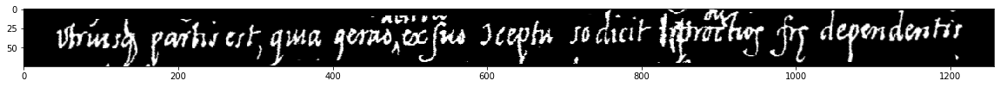

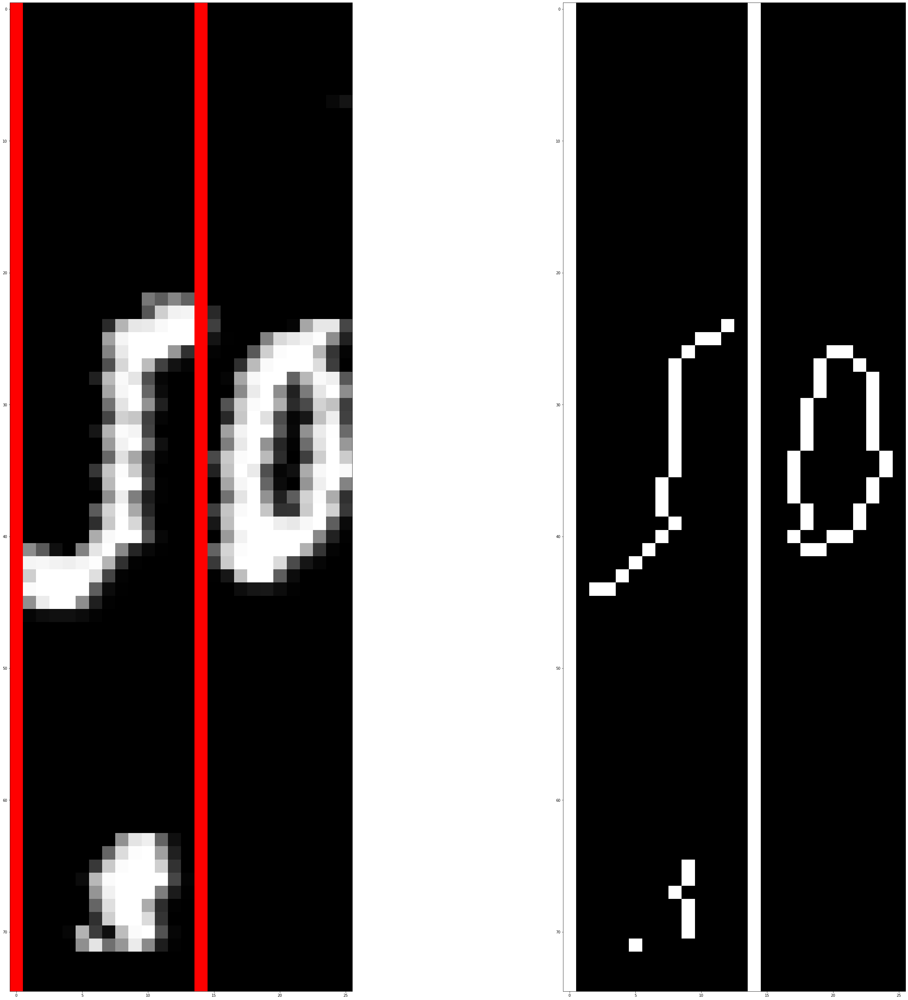

[ 0 13 14 25 26]


In [22]:
from skimage.morphology import skeletonize

i = 0
crop = []
init1 = 0
a = 0
b = 0
c = 0
i = 0
x = 0
y = 0
j = 0
separacion = skeletonization[6].copy()  # Se escoge una palabra del renglon
palabra_c = palabra[6].copy()
palabra_c = cv2.cvtColor(palabra_c, cv2.COLOR_GRAY2RGB)
fil, col = separacion.shape

for i in range(col):  # Se suman todas las columnas que componen la palabra
    # print(np.sum(separacion[0:fil,i:i+1]))
    if np.sum(separacion[0:fil, i : i + 1]) == 0:
        x = i - a
        y = i
        coord1 = int((x + y) / 2)
        crop.append(coord1)
        a = a + 1
        print(x, y, coord1, np.sum(separacion[0:fil, i : i + 1]))
    elif np.sum(separacion[0:fil, i : i + 1]) == 255:
        x = i - b
        y = i
        coord2 = int((x + y) / 2)
        b = b + 1
    else:
        if a > 0:
            x = 0
            y = 0
            image = cv2.line(palabra_c, (coord1, 0), (coord1, fil), (255, 0, 0), 1)
            image1 = cv2.line(
                separacion, (coord1, 0), (coord1, fil), (255, 255, 255), 1
            )
            # print(a)
        a = 0

        if b > 4 and b < 6:
            x = 0
            y = 0
            image = cv2.line(palabra_c, (coord2, 0), (coord2, fil), (0, 255, 0), 1)
            image1 = cv2.line(
                separacion, (coord2, 0), (coord2, fil), (255, 255, 255), 1
            )
            # print(b)
        b = 0

print(col)

plt.figure(figsize=(20, 20))
plt.imshow(linea_c_deslant, cmap=plt.cm.gray)
plt.show()
plt.figure(figsize=(50, 50))
# for j in range(len(crop)):
#    plt.subplot(int(len(crop) / 2) + 1, 2, j + 1), plt.imshow(
#        crop[j], cmap=plt.cm.gray)
plt.subplot(1, 2, 1), plt.imshow(image, cmap=plt.cm.gray)
plt.subplot(1, 2, 2), plt.imshow(image1, cmap=plt.cm.gray)
plt.show()
crop.append(col)
crop = np.unique(crop)
print(crop)